# Predictive maintenance of Lathe machine

#### Importing important libraries and modules

In [4]:
import pandas as pd
import numpy as np
import torch 
import tensorflow as tf
import matplotlib as mpl
from matplotlib import pyplot as plt
import seaborn as sns

#### Importing Vibration Data and converting it to proper Time-series format.

In [5]:
dataframes = []  # To store the imported data from each file

for i in range(1, 61):
    file = f"Data/{i}.xlsx"
    df = pd.read_excel(file)  # Use pd.read_excel() for Excel files
    df = df.dropna(axis='columns', how='all')  # Drop empty columns
    df = df.dropna(axis='rows', how='all')  # Drop empty rows
    df.columns = ['Time', 'X', 'Y', 'Z']  # Assign column names explicitly
    df = df.iloc[1:]  # Exclude the original header row from the data
    df['Time'] = pd.to_datetime(df['Time'], unit='s').dt.time  # Convert 'Time' column to datetime
    dataframes.append(df)
    print(i) #too keep an eye on progress
exp = pd.read_excel("Data/Experiment Summary.xlsx")


1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60


In [78]:
#view imported data.

for i in range(60):
    print(i, dataframes[i].shape, dataframes[i].head(5))

0 (98816, 4)               Time         X         Y         Z
1         00:00:00 -0.961714 -2.247089  -4.40107
2  00:00:00.000976 -0.394591 -2.298639 -1.552597
3  00:00:00.001953  -5.44346  0.849591   5.49498
4  00:00:00.002929  -1.46255   0.77963  1.958311
5  00:00:00.003906  1.148426   1.03738 -1.342826
1 (102400, 4)               Time         X         Y         Z
1         00:00:00 -1.212132  1.217805  3.375187
2  00:00:00.000976 -1.370485  1.744351  2.039275
3  00:00:00.001953  3.089165  2.274579 -0.801837
4  00:00:00.002929  0.120975  1.409276  -0.48534
5  00:00:00.003906 -0.928571 -0.203501  0.887373
2 (103424, 4)               Time         X         Y         Z
1         00:00:00 -3.554277  0.234673  1.156028
2  00:00:00.000976 -3.035028 -0.895744  2.050316
3  00:00:00.001953 -1.016954  1.600747 -0.095239
4  00:00:00.002929  -2.09596 -1.227136 -1.821252
5  00:00:00.003906  0.323519  1.103658 -1.497394
3 (97792, 4)               Time         X         Y         Z
1         00:00

In [6]:
import plotly.express as px

def time_domain(num):
    df = dataframes[num]

    # Create a line plot using Plotly
    fig = px.line(df, x='Time', y=['X', 'Y', 'Z'], title='Vibration Sensor Data')

    # Display the plot
    fig.show()
    


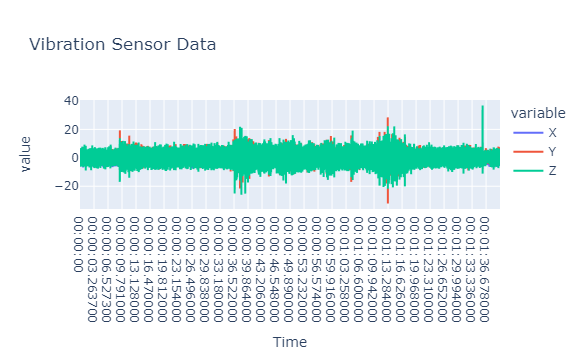

In [10]:
new = time_domain(1), 